<a href="https://colab.research.google.com/github/Stanley-Wang910/spotify-rec-engine/blob/fixes-branch/genre_classifier_xgboost.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files
files.upload()

Saving rec_dataset.csv to rec_dataset.csv


{'rec_dataset.csv': b'artists,track_name,track_id,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre\r\nGen Hoshino,Comedy,5SuOikwiRyPMVoIQDJUgSV,73,230666,0.676,0.461,1,-6.746,0,0.143,0.0322,1.01e-06,0.358,0.715,87.917,4.0,Indie\r\nBen Woodward,Ghost - Acoustic,4qPNDBW1i3p13qLCt0Ki3A,55,149610,0.42,0.166,1,-17.235,1,0.0763,0.924,5.56e-06,0.101,0.267,77.489,4.0,Indie\r\nIngrid Michaelson;ZAYN,To Begin Again,1iJBSr7s7jYXzM8EGcbK5b,57,210826,0.438,0.359,0,-9.734,1,0.0557,0.21,0.0,0.117,0.12,76.332,4.0,Indie\r\nKina Grannis,Can\'t Help Falling In Love,6lfxq3CG4xtTiEg7opyCyx,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.905,7.07e-05,0.132,0.143,181.74,3.0,Indie\r\nChord Overstreet,Hold On,5vjLSffimiIP26QG5WcN2K,82,198853,0.618,0.443,2,-9.681,1,0.0526,0.469,0.0,0.0829,0.167,119.949,4.0,Indie\r\nTyrone Wells,Days I Will Remember,01MVOl9KtVTNfFiBU9I7dc,58,214240,0.688,0.481,6,-8.807,1,0.105,0.2

### Libraries & Imports

In [ ]:
import pandas as pd
import random
import numpy as np
from sklearn.preprocessing import LabelEncoder
import pandas as pd
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import numpy as np
from scipy import stats
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.preprocessing import LabelEncoder, StandardScaler
import plotly.express as px
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
import seaborn as sns
import matplotlib.pyplot as plt

### Read Data

In [ ]:
random.seed(12975910)
df = pd.read_csv('rec_dataset.csv')
df.dropna(how='all', inplace=True)
df.drop_duplicates(subset='track_id', inplace=True)
df = df.drop('time_signature', axis=1)
print(df.isnull().sum())
df = df.groupby('track_genre').apply(lambda x: x.sample(min(len(x), 5000))).reset_index(drop=True)

print(df['track_genre'].value_counts())
df.head()

artists             1
track_name          2
track_id            0
popularity          0
duration_ms         0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
track_genre         0
dtype: int64
track_genre
Alternative    5000
Anime          5000
Soundtrack     5000
Soul           5000
Rock           5000
Reggaeton      5000
Reggae         5000
R&B            5000
Pop            5000
Opera          5000
Jazz           5000
Indie          5000
Hip-Hop        5000
Folk           5000
Electronic     5000
Dance          5000
Country        5000
Classical      5000
Blues          5000
World          5000
Name: count, dtype: int64


,artists,track_name,track_id,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,track_genre
0,Arcade Fire,Wake Up,6Hmj7SrLRbreLVfVS7mV1S,63,335333,0.252,0.800,0,-4.845,1,0.0368,0.120000,0.05380,0.118,0.290,139.361,Alternative
1,Ari Lennox,Yuengling,3ivqs39ibL7diQLRy5f1ex,42,163707,0.866,0.349,2,-8.810,1,0.0955,0.638000,0.00123,0.102,0.554,110.020,Alternative
2,Disturbed,The Game,2Cl6IRZXobSICf5U6EE1uI,55,226893,0.628,0.950,8,-3.020,1,0.0559,0.000141,0.00516,0.151,0.563,132.001,Alternative
3,Loudon Wainwright III,The Swimming Song,6scUEism6pBnY0IXYr8fw3,49,147467,0.604,0.585,9,-11.288,1,0.0329,0.408000,0.08860,0.109,0.670,92.521,Alternative
4,Red Fang,Wires,4yl1IpHPuXUV2MjxXy6hZn,50,343307,0.172,0.904,11,-4.831,1,0.0586,0.000054,0.22900,0.267,0.302,135.149,Alternative


### Visualize Data

<function matplotlib.pyplot.show(close=None, block=None)>

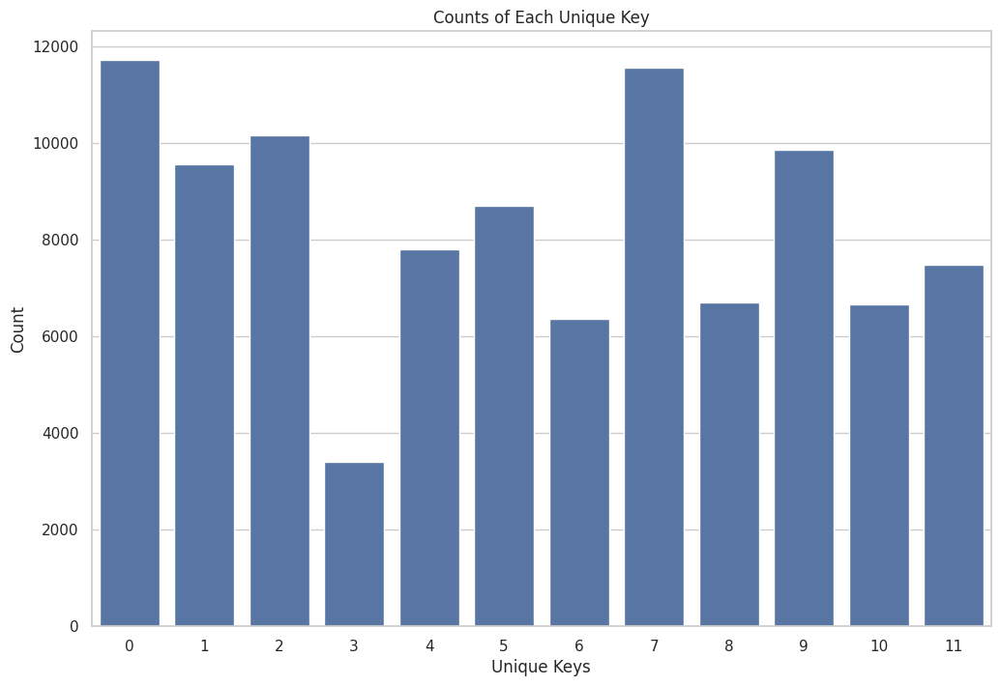

In [ ]:
key_counts = df['key'].value_counts()

sorted_key_counts = key_counts.sort_index()

sns.set(style="whitegrid")

plt.figure(figsize=(12, 8))
sns.barplot(x=sorted_key_counts.index, y=sorted_key_counts.values)
plt.xlabel('Unique Keys')
plt.ylabel('Count')
plt.title('Counts of Each Unique Key')
plt.show

In [ ]:
na_rows = df[df.isna().any(axis=1)]
df['duration_ms'] = df['duration_ms']
df.replace(to_replace=['?', -1], value=np.nan, inplace=True)


percent_missing = df.isna().mean() * 100
for column, percentage in percent_missing.items():
    print(f"{column}: {percentage:.4f}% missing values")
na_rows

artists: 0.0000% missing values
track_name: 0.0010% missing values
track_id: 0.0000% missing values
popularity: 0.0000% missing values
duration_ms: 0.0000% missing values
danceability: 0.0000% missing values
energy: 0.0000% missing values
key: 0.0000% missing values
loudness: 0.0000% missing values
mode: 0.0000% missing values
speechiness: 0.0000% missing values
acousticness: 0.0000% missing values
instrumentalness: 0.0000% missing values
liveness: 0.0000% missing values
valence: 0.0000% missing values
tempo: 0.0000% missing values
track_genre: 0.0000% missing values


,artists,track_name,track_id,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,track_genre
99960,Elevation Worship,NaN,7BGQCe62A58Q5ZgpQFX93t,44,350027,0.287,0.446,5,-7.214,1,0.0317,0.019,0.0,0.1,0.0387,138.727,World


In [ ]:
unique_values = df['track_genre'].unique()
print(f"Unique values in column track_genre:", unique_values)

Unique values in column track_genre: ['Alternative' 'Anime' 'Blues' 'Classical' 'Country' 'Dance' 'Electronic'
 'Folk' 'Hip-Hop' 'Indie' 'Jazz' 'Opera' 'Pop' 'R&B' 'Reggae' 'Reggaeton'
 'Rock' 'Soul' 'Soundtrack' 'World']


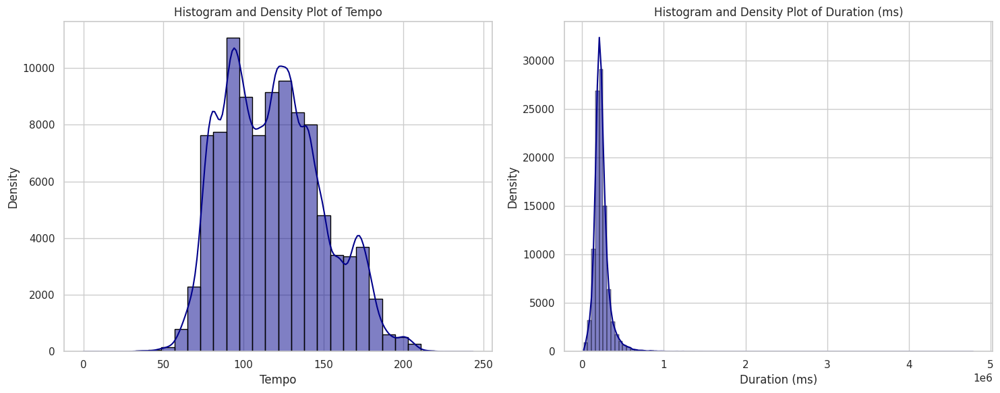

In [ ]:
plottable_df = df.copy()
plottable_df['tempo'] = pd.to_numeric(plottable_df['tempo'], errors='coerce')
plottable_df['duration_ms'] = pd.to_numeric(plottable_df['duration_ms'], errors='coerce')

plottable_df = plottable_df.dropna(subset=['tempo', 'duration_ms'])

fig, axes = plt.subplots(1, 2, figsize=(15, 6))

sns.histplot(ax=axes[0], data=plottable_df, x='tempo', kde=True, bins=30, color = 'darkblue', edgecolor='black')

axes[0].set_title('Histogram and Density Plot of Tempo')
axes[0].set_xlabel('Tempo')
axes[0].set_ylabel('Density')

sns.histplot(ax=axes[1], data=plottable_df, x='duration_ms', kde=True, bins=100, color='darkblue', edgecolor='black')
axes[1].set_title('Histogram and Density Plot of Duration (ms)')
axes[1].set_xlabel('Duration (ms)')
axes[1].set_ylabel('Density')

plt.tight_layout()
plt.show()

In [ ]:
shapiro_test = stats.shapiro(plottable_df['duration_ms'])


print("Shapiro-Wilk test statistic for tempo:", shapiro_test[0])
print("p-value:", shapiro_test[1])


if shapiro_test[1] < 0.05:
  print("Reject null hypothesis, data is not normally distributed.")
else:
  print("Fail to reject null hypothesis, data may be normally distributed.")


shapiro_test = stats.shapiro(plottable_df['tempo'])


print("Shapiro-Wilk test statistic for duration_ms:", shapiro_test[0])
print("p-value:", shapiro_test[1])


if shapiro_test[1] < 0.05:
  print("Reject null hypothesis, data is not normally distributed.")
else:
  print("Fail to reject null hypothesis, data may be normally distributed.")

Shapiro-Wilk test statistic for tempo: 0.6629778146743774
p-value: 0.0
Reject null hypothesis, data is not normally distributed.
Shapiro-Wilk test statistic for duration_ms: 0.9786892533302307
p-value: 0.0
Reject null hypothesis, data is not normally distributed.


### Preprocess the Data


In [ ]:
df['tempo'] = pd.to_numeric(df['tempo'], errors='coerce')
df['duration_ms'] = pd.to_numeric(df['duration_ms'], errors='coerce')
df.dropna(subset=['tempo', 'duration_ms'], inplace=True)

df = df.drop(['artists', 'track_name', 'track_id'], axis=1)


label_encoder = LabelEncoder()
df['track_genre']  = label_encoder.fit_transform(df['track_genre'])
df = pd.get_dummies(df, columns=['key'])

df.head()

,popularity,duration_ms,danceability,energy,loudness,mode,speechiness,acousticness,instrumentalness,liveness,...,key_2,key_3,key_4,key_5,key_6,key_7,key_8,key_9,key_10,key_11
0,63,335333,0.252,0.800,-4.845,1,0.0368,0.120000,0.05380,0.118,...,False,False,False,False,False,False,False,False,False,False
1,42,163707,0.866,0.349,-8.810,1,0.0955,0.638000,0.00123,0.102,...,True,False,False,False,False,False,False,False,False,False
2,55,226893,0.628,0.950,-3.020,1,0.0559,0.000141,0.00516,0.151,...,False,False,False,False,False,False,True,False,False,False
3,49,147467,0.604,0.585,-11.288,1,0.0329,0.408000,0.08860,0.109,...,False,False,False,False,False,False,False,True,False,False
4,50,343307,0.172,0.904,-4.831,1,0.0586,0.000054,0.22900,0.267,...,False,False,False,False,False,False,False,False,False,True


In [ ]:
genres = df['track_genre'].unique()
train_frames = []
test_frames = []

for genre in genres:
  genre_data = df[df['track_genre'] == genre]
  # a test size of 500 per each genre instance, ensuring a total balanced test set
  genre_train, genre_test = train_test_split(genre_data, test_size=500, shuffle=True)
  train_frames.append(genre_train)
  test_frames.append(genre_test)

train_df = pd.concat(train_frames)
test_df = pd.concat(test_frames)

print(test_df['track_genre'].value_counts())

track_genre
0     500
1     500
18    500
17    500
16    500
15    500
14    500
13    500
12    500
11    500
10    500
9     500
8     500
7     500
6     500
5     500
4     500
3     500
2     500
19    500
Name: count, dtype: int64


### Dimensionality Reduction

In [ ]:
# To see which linear combination of features is most responsible for determining the variance of class items (genres)
# PCA didn't net good results, could potentially try re-fitting model using LDA reducd featuresets

columns_to_drop = [col for col in train_df.columns if 'key' in col or col == 'mode']
reduct_df = train_df.drop(columns=columns_to_drop)
X = reduct_df.drop('track_genre', axis=1)
y_encoded = reduct_df['track_genre']

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(n_components=3)

X_pca = pca.fit_transform(X_scaled)

pca_explained_variance = pca.explained_variance_ratio_
print(pca_explained_variance)

df_pca_result = pd.DataFrame(X_pca, columns=[f'PCA{i+1}' for i in range(X_pca.shape[1])])
df_pca_result['Track Genre'] = label_encoder.inverse_transform(y_encoded)

print("Inverse transformed labels: ", df_pca_result['Track Genre'].unique())

fig = px.scatter_3d(df_pca_result, x='PCA1', y='PCA2', z='PCA3',
                    color='Track Genre',
                    title="3D PCA Projection of Music Tracks",
                    opacity=1.0)

fig.update_traces(marker=dict(size=1))

fig.show()

# lda = LDA(n_components=3)

# X_lda = lda.fit_transform(X_scaled, y_encoded)

# lda_explained_variance = lda.explained_variance_ratio_
# print(lda_explained_variance)

# reduct_df_result = pd.DataFrame(X_lda, columns=[f'LDA{i+1}' for i in range(X_lda.shape[1])])
# reduct_df_result['Track Genre'] = label_encoder_reduct.inverse_transform(y_encoded)

# fig = px.scatter_3d(reduct_df_result, x='LDA1', y='LDA2', z='LDA3',
#                     color='Track Genre',
#                     title="3D LDA Projection of Music Tracks",
#                     opacity=1.0)

# fig.update_traces(marker=dict(size=1))

# fig.show()



377       0
1726      0
247       0
1704      0
3571      0
         ..
99705    19
95163    19
97625    19
98214    19
96785    19
Name: track_genre, Length: 90000, dtype: int64
[0.32925841 0.11318461 0.09806699]
Inverse transformed labels:  ['Alternative' 'Anime' 'Blues' 'Classical' 'Country' 'Dance' 'Electronic'
 'Folk' 'Hip-Hop' 'Indie' 'Jazz' 'Opera' 'Pop' 'R&B' 'Reggae' 'Reggaeton'
 'Rock' 'Soul' 'Soundtrack' 'World']


### Prepare Data for Model

### Fit Model


In [ ]:
### Grid Search CV

X_train = train_df.drop('track_genre', axis=1)
y_train = train_df['track_genre']

X_test = test_df.drop('track_genre', axis=1)
y_test = test_df['track_genre']



# Define the parameter grid
params = {
    'max_depth': [2, 3, 4, 5, 7, 12],
    'eta': [0.1, 0.2, 0.3, 0.4, 0.5],
    'objective': ['multi:softmax'],
    'num_class': [len(y_train.unique())]
}

# Initialize the XGBClassifier with the checkpoint callback
base_model = xgb.XGBClassifier()

# Set up StratifiedKFold
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize GridSearchCV with the checkpointing-enabled model
grid_search = GridSearchCV(
    estimator=base_model,
    param_grid=params,
    scoring='accuracy',
    cv=kf,
    verbose=2
)

# Fit the model
grid_search.fit(X_train, y_train)

print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score: {:.2f}".format(grid_search.best_score_))

# Get the best model
best_model = grid_search.best_estimator_

# Make predictions on the test set
y_pred = best_model.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy: %.2f%%" % (accuracy * 100))

# Optional: Save the final best model
best_model.save_model("final_best_model.json")

Fitting 5 folds for each of 30 candidates, totalling 150 fits
Model saved at iteration 50
Model saved at iteration 100
[CV] END eta=0.1, max_depth=2, num_class=20, objective=multi:softmax; total time=  22.0s
Model saved at iteration 50
Model saved at iteration 100
[CV] END eta=0.1, max_depth=2, num_class=20, objective=multi:softmax; total time=  28.1s
Model saved at iteration 50
Model saved at iteration 100
[CV] END eta=0.1, max_depth=2, num_class=20, objective=multi:softmax; total time=  16.1s
Model saved at iteration 50
Model saved at iteration 100
[CV] END eta=0.1, max_depth=2, num_class=20, objective=multi:softmax; total time=  18.8s
Model saved at iteration 50
Model saved at iteration 100
[CV] END eta=0.1, max_depth=2, num_class=20, objective=multi:softmax; total time=  17.2s
Model saved at iteration 50
Model saved at iteration 100
[CV] END eta=0.1, max_depth=3, num_class=20, objective=multi:softmax; total time=  20.6s
Model saved at iteration 50
Model saved at iteration 100
[CV] 

In [ ]:
from sklearn.metrics import roc_curve, auc, classification_report

print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score: {:.2f}".format(grid_search.best_score_))

accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy: %.2f%%" % (accuracy * 100))
# report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
# print(report)


# --- Best Parameters ---
# Best parameters: {'eta': 0.1, 'max_depth': 12, 'num_class': 20, 'objective': 'multi:softmax'}

Best parameters: {'eta': 0.1, 'max_depth': 12, 'num_class': 20, 'objective': 'multi:softmax'}
Best cross-validation score: 0.46
Test set accuracy: 47.21%


In [ ]:
# Retrain if needed on same random seed and best params

from sklearn.model_selection import cross_val_score

columns_to_scale = ['popularity', 'duration_ms', 'danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']

scaler = StandardScaler()

X_train = train_df.drop('track_genre', axis=1)
X_test = test_df.drop('track_genre', axis=1)

X_train_scaled = X_train.copy()
X_train_scaled[columns_to_scale] = scaler.fit_transform(X_train[columns_to_scale])


X_test_scaled = X_test.copy()
X_test_scaled[columns_to_scale] = scaler.transform(X_test[columns_to_scale])

y_train = train_df['track_genre']
y_test = test_df['track_genre']

best_params = {
    'max_depth': 12,
    'eta': 0.1,
    'objective': 'multi:softmax',
    'num_class': len(y_train.unique())
}

model = xgb.XGBClassifier(**best_params)

model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy: %.2f%%" % (accuracy* 100))


### Save Model

In [ ]:
import joblib
# Save the best model
joblib.dump(model, "xgboost_model.joblib")

# Save the order of columns of the X_train data
joblib.dump(X_train_scaled.columns, "feature_set.joblib")

# Save the scaler
joblib.dump(scaler, "scaler.joblib")

# Save the label encoder
joblib.dump(label_encoder, "label_encoder.joblib")

# Download the saved files
files.download("xgboost_model.joblib")
files.download("feature_set.joblib")
files.download("scaler.joblib")
files.download("label_encoder.joblib")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Visualize Confusion Matrix

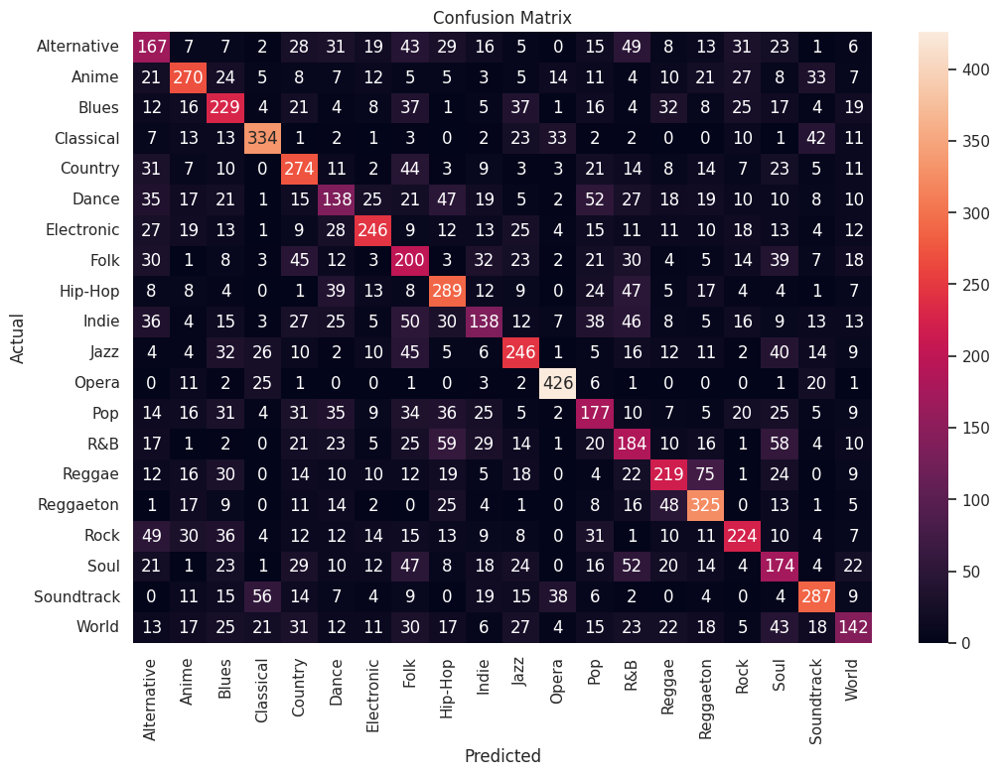

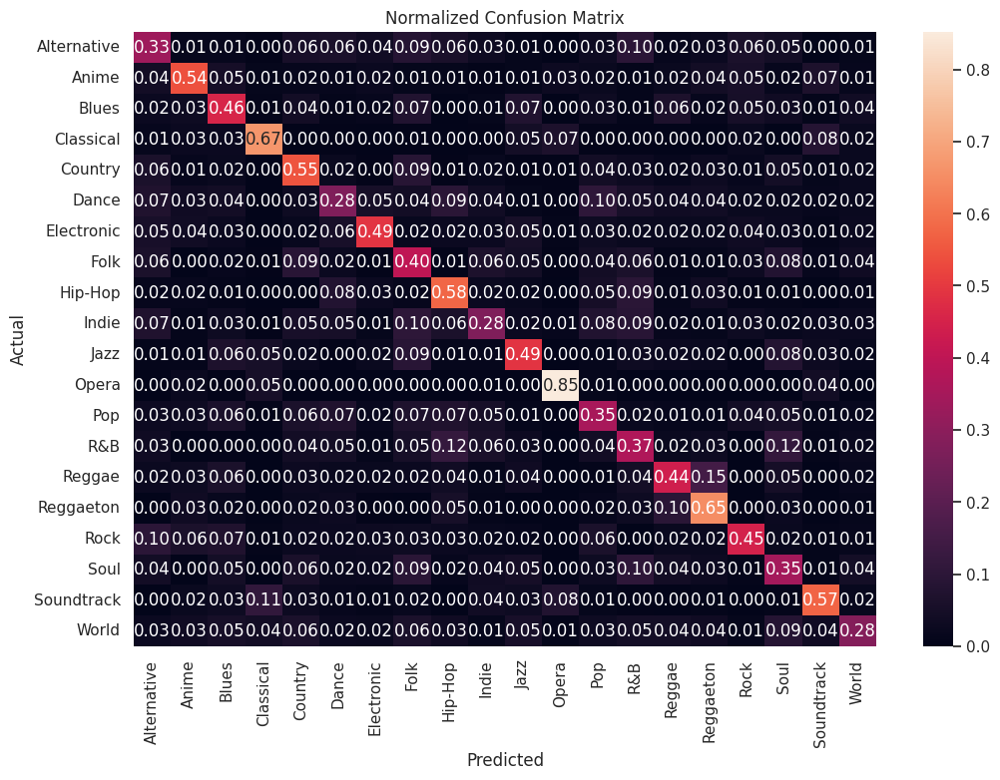

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix


conf_mat = confusion_matrix(y_test, y_pred)

labels = label_encoder.inverse_transform(range(len(label_encoder.classes_)))


# Plot confusion matrix
plt.figure(figsize=(12, 8))
sns.heatmap(conf_mat, annot=True, fmt="d", xticklabels=labels, yticklabels=labels)
plt.title("Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")

# Compute normalized confusion matrix
normalized_conf_mat = conf_mat / conf_mat.sum(axis=1, keepdims=True)

# Plot normalized confusion matrix
plt.figure(figsize=(12, 8))
sns.heatmap(normalized_conf_mat, annot=True, fmt=".2f", xticklabels=labels, yticklabels=labels)
plt.title("Normalized Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")

plt.show()